## **Notebook EC#13**
## Simple Recurrent Neural Network, Linear Predictor, MLP and LSTM for multi-step time series prediction.<BR>

**Professor:** Fernando J. Von Zuben <br>
**Aluno(a):** Túlio queiroz de Paula

In [3]:
# Loading all the relevant libraries
from pandas import read_csv
from pandas import DataFrame
import numpy as np
import pandas as pd
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, SimpleRNN, LSTM, GRU
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import math
import matplotlib.pyplot as plt

#### **Please, upload the datasets [monthly_sunspot.csv] and [unemployment_rate.csv] before executing the code. The datasets are provided together with this code. The dataset [unemployment rate] is available at [this link](https://fred.stlouisfed.org/series/UNRATE). The dataset [monthly_sunspot.csv] is available at [this link](https://github.com/jbrownlee/Datasets/blob/master/monthly-sunspots.csv).**

In [4]:
# Structuring the dataset from a single time series, scaling and spliting into training / testing
def get_train_test(dataset, split_percent, time_steps, horizon):
    df = read_csv(dataset, usecols=[1], engine='python')
    data = np.array(df.values.astype('float32'))
    scaler = MinMaxScaler(feature_range=(0, 1))
    # There is a kind of data leakage in the next command
    data = scaler.fit_transform(data).flatten()
    n = len(data)
    df = DataFrame()
    for i in range(0,time_steps):
      df['t-' + str(time_steps-i-1)] = [data[j] for j in range(i, (len(data)-horizon-time_steps+i+1))]
    for i in range(1,horizon+1):
      df['t+' + str(i)] = [data[j] for j in range(time_steps+i-1, (len(data)-horizon+i))]
    print(df)
    df1 = df.copy()
    for i in range(1,horizon+1):
      df1 = df1.drop(['t+' + str(i)], axis = 1)
    dataX = np.array(df1) #separacao de dados de time_steps
    df2 = df['t+1']
    for i in range(2,horizon+1):
      df2 = pd.concat([df2, df['t+' + str(i)]], axis=1)
    datay = np.array(df2) #separacao de dados de horizon
    # Point for splitting data into train and test
    split = int(n*split_percent)
    X = dataX[range(split),:]
    y = datay[range(split)]
    Xt = dataX[split:,:]
    yt = datay[split:]
    return X, y, Xt, yt

time_steps = 11
horizon = 3
# Here you will decide which dataset to consider.
# X, y, Xt, yt = get_train_test('unemployment_rate.csv', 0.8, time_steps, horizon)
X, y, Xt, yt = get_train_test('data/monthly_sunspot.csv', 0.8, time_steps, horizon)

          t-10       t-9       t-8       t-7       t-6       t-5       t-4  \
0     0.228526  0.246651  0.275808  0.219464  0.334909  0.328999  0.373522   
1     0.246651  0.275808  0.219464  0.334909  0.328999  0.373522  0.261229   
2     0.275808  0.219464  0.334909  0.328999  0.373522  0.261229  0.299054   
3     0.219464  0.334909  0.328999  0.373522  0.261229  0.299054  0.297478   
4     0.334909  0.328999  0.373522  0.261229  0.299054  0.297478  0.624901   
...        ...       ...       ...       ...       ...       ...       ...   
2802  0.418046  0.423956  0.468085  0.373128  0.386525  0.500394  0.332151   
2803  0.423956  0.468085  0.373128  0.386525  0.500394  0.332151  0.200946   
2804  0.468085  0.373128  0.386525  0.500394  0.332151  0.200946  0.262017   
2805  0.373128  0.386525  0.500394  0.332151  0.200946  0.262017  0.317967   
2806  0.386525  0.500394  0.332151  0.200946  0.262017  0.317967  0.390859   

           t-3       t-2       t-1       t-0       t+1       t+

#### **Please, to switch between the two datasets, comment the appropriate command at the end of the code cell above and uncomment the other.**

In [5]:
print(X.shape)
print(y.shape)

(2256, 11)
(2256, 3)


## **Implementing the simple recurrent neural network**

In [6]:
# Execute this cell or the cell associated with one of the other predictors. They are mutually exclusive.
def create_RNN(hidden_units, dense_units, input_shape, activation):
        model = Sequential()
        model.add(SimpleRNN(hidden_units, activation=activation[0], input_shape=input_shape))
        model.add(Dense(units=dense_units, activation=activation[1]))
        model.compile(loss='mean_squared_error', optimizer='adam')
        return model

def RNN_predictor (X, y, time_steps):
    model = create_RNN(hidden_units=30, dense_units=horizon, input_shape=(time_steps,1), activation=['tanh', 'tanh'])
    train_predict = model.fit(X, y, epochs=20, batch_size=1, verbose=2)
    return model

RNN_model = RNN_predictor(X, y, time_steps)

Epoch 1/20


/home/tulio-queiroz/Documents/repos/repos-unicamp/ea072/inteligencia-artificial/.venv/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2256/2256 - 3s - 2ms/step - loss: 0.0056
Epoch 2/20
2256/2256 - 2s - 1ms/step - loss: 0.0047
Epoch 3/20
2256/2256 - 2s - 1ms/step - loss: 0.0047
Epoch 4/20
2256/2256 - 2s - 1ms/step - loss: 0.0047
Epoch 5/20
2256/2256 - 2s - 1ms/step - loss: 0.0047
Epoch 6/20
2256/2256 - 2s - 1ms/step - loss: 0.0047
Epoch 7/20
2256/2256 - 2s - 1ms/step - loss: 0.0046
Epoch 8/20
2256/2256 - 2s - 1ms/step - loss: 0.0046
Epoch 9/20
2256/2256 - 2s - 1ms/step - loss: 0.0046
Epoch 10/20
2256/2256 - 2s - 1ms/step - loss: 0.0046
Epoch 11/20
2256/2256 - 2s - 1ms/step - loss: 0.0045
Epoch 12/20
2256/2256 - 2s - 1ms/step - loss: 0.0046
Epoch 13/20
2256/2256 - 2s - 1ms/step - loss: 0.0046
Epoch 14/20
2256/2256 - 2s - 1ms/step - loss: 0.0045
Epoch 15/20
2256/2256 - 2s - 989us/step - loss: 0.0046
Epoch 16/20
2256/2256 - 3s - 1ms/step - loss: 0.0045
Epoch 17/20
2256/2256 - 2s - 1ms/step - loss: 0.0045
Epoch 18/20
2256/2256 - 2s - 1ms/step - loss: 0.0045
Epoch 19/20
2256/2256 - 2s - 1ms/step - loss: 0.0045
Epoch 20/20

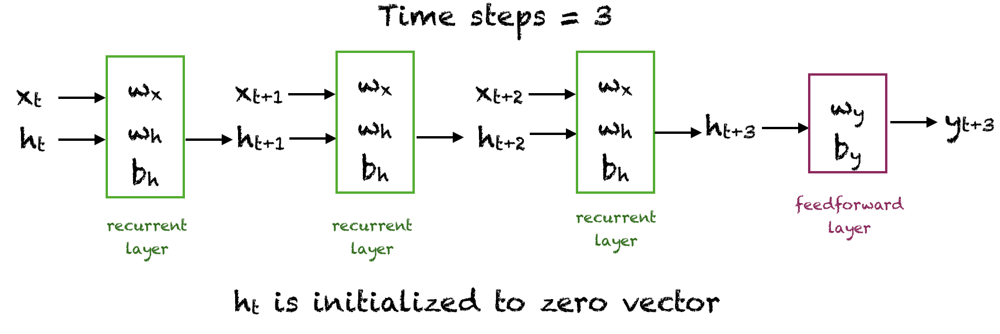

In [7]:
# Configuration of the simple RNN
from IPython.display import Image
Image("RNN_info_flow.png", width = 600, height = 300)

In [8]:
wx = RNN_model.get_weights()[0]
wh = RNN_model.get_weights()[1]
bh = RNN_model.get_weights()[2]
wy = RNN_model.get_weights()[3]
by = RNN_model.get_weights()[4]
print(wx.shape)
print(wh.shape)
print(bh.shape)
print(wy.shape)
print(by.shape)

(1, 30)
(30, 30)
(30,)
(30, 3)
(3,)


## **Implementing a linear predictor**

In [9]:
# Execute this cell or the cell associated with one of the other predictors. They are mutually exclusive.
def linear_predictor(X,y):
    model = LinearRegression()
    train_predict = model.fit(X, y)
    print(model.coef_)
    print(model.intercept_)

    return model

linear_model = linear_predictor(X,y)

[[-0.03231146 -0.03466102  0.07275832  0.00478102 -0.01082086  0.06693842
   0.04085782  0.08718778  0.07405275  0.13080612  0.5568414 ]
 [-0.080745   -0.01733854  0.01364115  0.08068246  0.00291333  0.03024402
   0.09379475  0.09038368  0.12686118  0.15160787  0.43763572]
 [-0.10533427 -0.04564717  0.02615339  0.02253821  0.08277372  0.03709101
   0.05409294  0.13282879  0.12137729  0.19044921  0.39070648]]
[0.0076317  0.01236634 0.01638973]


## **Implementing the multilayer perceptron neural network (MLP)**

In [10]:
# Execute this cell or the cell associated with one of the other predictors. They are mutually exclusive.
def MLP_predictor():
  model = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(80, activation=tf.nn.tanh),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(horizon, activation='linear')
  ])
  model.compile(optimizer='adam', loss='mean_squared_error')
  train_predict = model.fit(X, y, epochs=100)
  model.summary()

  return model

MLP_model = MLP_predictor()

Epoch 1/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 1s 791us/step - loss: 0.0408
Epoch 2/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 700us/step - loss: 0.0118
Epoch 3/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 756us/step - loss: 0.0085
Epoch 4/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 714us/step - loss: 0.0073
Epoch 5/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 805us/step - loss: 0.0067
Epoch 6/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 783us/step - loss: 0.0061
Epoch 7/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 825us/step - loss: 0.0060
Epoch 8/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 697us/step - loss: 0.0055
Epoch 9/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 772us/step - loss: 0.0060
Epoch 10/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 774us/step - loss: 0.0055
Epoch 11/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 679us/step - loss: 0.0054
Epoch 12/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 760us/step - loss: 0.0052
Epoch 13/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 695us/step - loss: 0.0052
Epoch 14/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 669us/step - loss: 0.0051
Epoch 15/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 

71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 742us/step - loss: 0.0046
Epoch 81/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 717us/step - loss: 0.0045
Epoch 82/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 704us/step - loss: 0.0045
Epoch 83/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 697us/step - loss: 0.0044
Epoch 84/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 771us/step - loss: 0.0047
Epoch 85/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 758us/step - loss: 0.0043
Epoch 86/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 689us/step - loss: 0.0045
Epoch 87/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 745us/step - loss: 0.0044
Epoch 88/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 751us/step - loss: 0.0046
Epoch 89/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 650us/step - loss: 0.0049
Epoch 90/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 702us/step - loss: 0.0047
Epoch 91/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 705us/step - loss: 0.0046
Epoch 92/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 704us/step - loss: 0.0048
Epoch 93/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 707us/step - loss: 0.0045
Epoch 94/100
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 745u

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten (Flatten)               │ (None, 11)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 80)             │           960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 80)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 3)              │           243 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,611 (14.11 KB)

 Trainable params: 1,203 (4.70 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 2,408 (9.41 KB)

## **Implementing the long short-term memory network (LSTM)**

In [11]:
def LSTM_predictor(X, y, time_steps):
    X1 = X.reshape(X.shape[0],time_steps,1)
    model=Sequential()
    model.add(LSTM(25,input_shape=(time_steps,1)))
    model.add(Dense(horizon,activation='linear'))
    model.compile(loss='mean_squared_error',optimizer='adam')

    train_predict = model.fit(X1,y,epochs=200,verbose=2)

    return model

LSTM_model = LSTM_predictor(X, y, time_steps)
print(LSTM_model.summary())

Epoch 1/200


/home/tulio-queiroz/Documents/repos/repos-unicamp/ea072/inteligencia-artificial/.venv/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


71/71 - 1s - 16ms/step - loss: 0.0174
Epoch 2/200
71/71 - 0s - 2ms/step - loss: 0.0064
Epoch 3/200
71/71 - 0s - 2ms/step - loss: 0.0060
Epoch 4/200
71/71 - 0s - 2ms/step - loss: 0.0057
Epoch 5/200
71/71 - 0s - 2ms/step - loss: 0.0055
Epoch 6/200
71/71 - 0s - 3ms/step - loss: 0.0052
Epoch 7/200
71/71 - 0s - 2ms/step - loss: 0.0051
Epoch 8/200
71/71 - 0s - 2ms/step - loss: 0.0049
Epoch 9/200
71/71 - 0s - 2ms/step - loss: 0.0048
Epoch 10/200
71/71 - 0s - 2ms/step - loss: 0.0048
Epoch 11/200
71/71 - 0s - 2ms/step - loss: 0.0048
Epoch 12/200
71/71 - 0s - 2ms/step - loss: 0.0047
Epoch 13/200
71/71 - 0s - 2ms/step - loss: 0.0047
Epoch 14/200
71/71 - 0s - 2ms/step - loss: 0.0047
Epoch 15/200
71/71 - 0s - 2ms/step - loss: 0.0046
Epoch 16/200
71/71 - 0s - 2ms/step - loss: 0.0046
Epoch 17/200
71/71 - 0s - 2ms/step - loss: 0.0046
Epoch 18/200
71/71 - 0s - 2ms/step - loss: 0.0046
Epoch 19/200
71/71 - 0s - 2ms/step - loss: 0.0045
Epoch 20/200
71/71 - 0s - 2ms/step - loss: 0.0046
Epoch 21/200
71/71 -

Epoch 164/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 165/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 166/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 167/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 168/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 169/200
71/71 - 0s - 3ms/step - loss: 0.0042
Epoch 170/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 171/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 172/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 173/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 174/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 175/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 176/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 177/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 178/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 179/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 180/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 181/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 182/200
71/71 - 0s - 2ms/step - loss: 0.0042
Epoch 183/200
71/71 - 0s - 2ms/

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 25)             │         2,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 3)              │            78 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 8,336 (32.57 KB)

 Trainable params: 2,778 (10.85 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 5,558 (21.71 KB)

None


In [12]:
def print_error(trainY, testY, train_predict, test_predict,i):
    # Error of predictions
    train_rmse = math.sqrt(mean_squared_error(trainY, train_predict))
    test_rmse = math.sqrt(mean_squared_error(testY, test_predict))
    # Print RMSE
    print('t+%d RMSE train: %.3f RMSE' % (i+1, train_rmse))
    print('t+%d RMSE test: %.3f RMSE' % (i+1, test_rmse))
    return [train_rmse, test_rmse]


def RMSE(train_predict, test_predict):
  rmse = []
  for i in range(horizon):
    if(horizon == 1):
      y1_pred = train_predict
      y1_pred_t = test_predict
      y1 = y
      y1_t = yt
    elif(horizon > 1):
      y1_pred = train_predict[:,i]
      y1_pred_t = test_predict[:,i]
      y1 = y[:,i]
      y1_t = yt[:,i]

    erro = print_error(y1, y1_t, y1_pred, y1_pred_t,i)
    rmse.append(erro)

  # Create a DataFrame from the rmse values for each horizon
  df = pd.DataFrame(rmse)
  df.columns = ['train', 'test']
  return df


In [13]:
# Plot the predictions together with the actual values
def plot_result(trainY, testY, train_predict, test_predict,i):
    actual = np.append(trainY, testY)
    predictions = np.append(train_predict, test_predict)
    rows = len(actual)
    plt.figure(figsize=(30, 6), dpi=300)
    plt.plot(range(rows), actual)
    plt.plot(range(rows), predictions)
    plt.axvline(x=len(trainY), color='r')
    plt.legend(['Actual', 'Predictions'])
    plt.xlabel('Time steps')
    plt.ylabel('Actual and Predicted Values')
    plt.title('t+%d Predition (The Red Line Separates The Training And Test Examples)' % (i+1))
    plt.grid(True)

def plot_predict(train_predict, test_predict, y, yt):
  for i in range(horizon):
    if(horizon == 1):
      y1_pred = train_predict
      y1_pred_t = test_predict
      y1 = y
      y1_t = yt
    elif(horizon > 1):
      y1_pred = train_predict[:,i]
      y1_pred_t = test_predict[:,i]
      y1 = y[:,i]
      y1_t = yt[:,i]
    plot_result(y1, y1_t, y1_pred, y1_pred_t,i)


***** RNN MODEL *****
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 967us/step
t+1 RMSE train: 0.060 RMSE
t+1 RMSE test: 0.082 RMSE
t+2 RMSE train: 0.068 RMSE
t+2 RMSE test: 0.096 RMSE
t+3 RMSE train: 0.073 RMSE
t+3 RMSE test: 0.100 RMSE


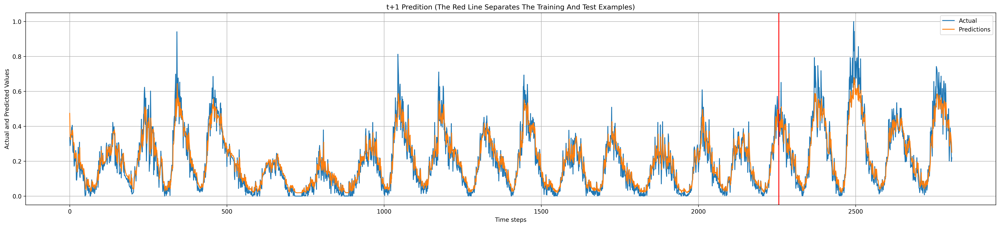

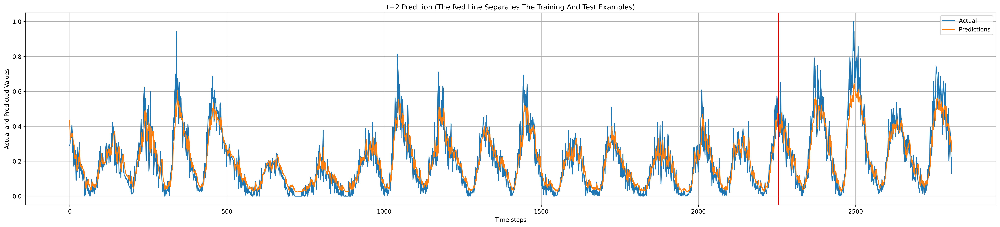

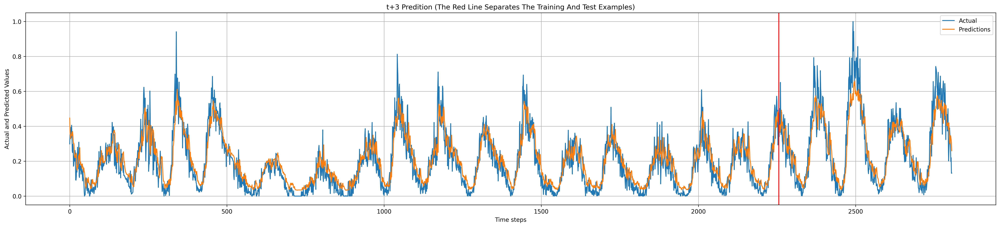

In [14]:
print ('***** RNN MODEL *****')
train_predict = RNN_model.predict(X)
test_predict = RNN_model.predict(Xt)
df1 = RMSE(train_predict, test_predict)
plot_predict(train_predict, test_predict, y, yt)

***** LINEAR MODEL *****
t+1 RMSE train: 0.058 RMSE
t+1 RMSE test: 0.073 RMSE
t+2 RMSE train: 0.067 RMSE
t+2 RMSE test: 0.087 RMSE
t+3 RMSE train: 0.071 RMSE
t+3 RMSE test: 0.093 RMSE


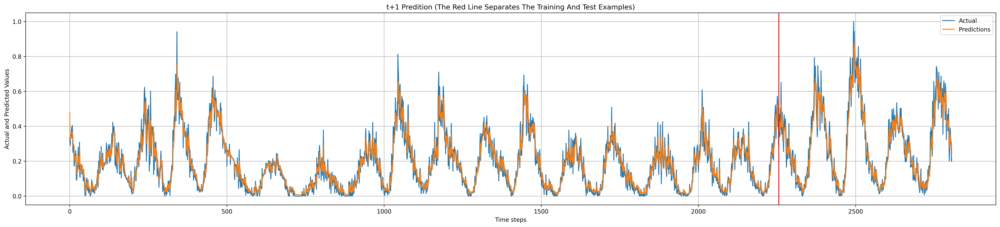

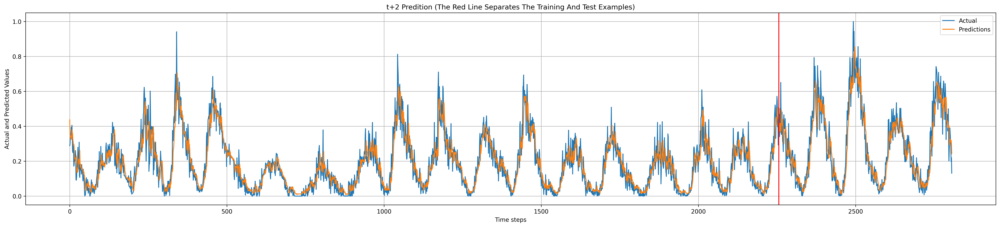

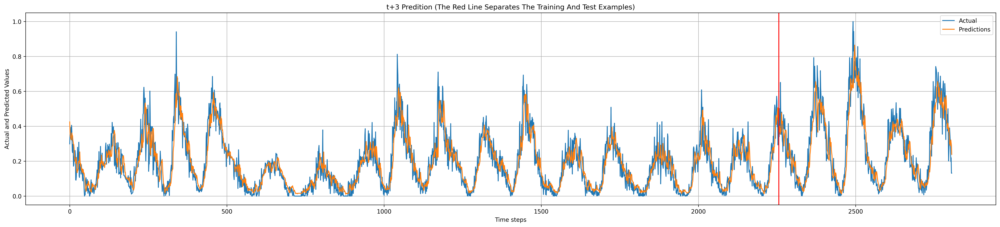

In [15]:
print ('***** LINEAR MODEL *****')
train_predict = linear_model.predict(X)
test_predict = linear_model.predict(Xt)
df2 = RMSE(train_predict, test_predict)
plot_predict(train_predict, test_predict, y, yt)

***** MLP MODEL *****
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 791us/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 631us/step
t+1 RMSE train: 0.059 RMSE
t+1 RMSE test: 0.075 RMSE
t+2 RMSE train: 0.067 RMSE
t+2 RMSE test: 0.089 RMSE
t+3 RMSE train: 0.071 RMSE
t+3 RMSE test: 0.095 RMSE


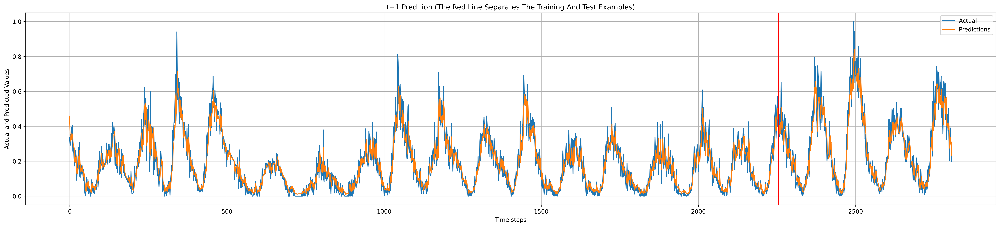

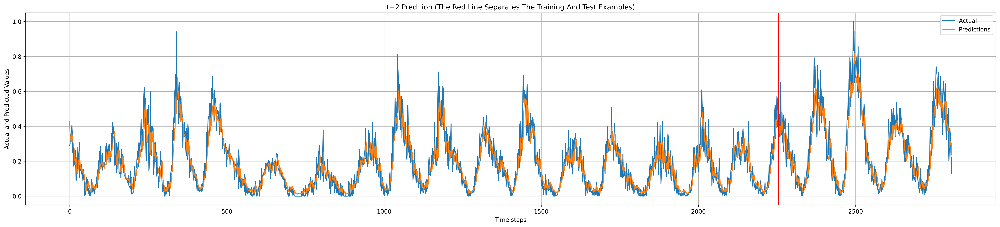

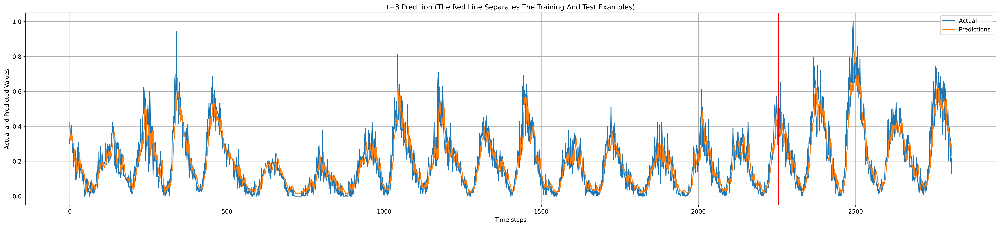

In [16]:
print ('***** MLP MODEL *****')
train_predict = MLP_model.predict(X)
test_predict = MLP_model.predict(Xt)
df3 = RMSE(train_predict, test_predict)
plot_predict(train_predict, test_predict, y, yt)

***** LSTM MODEL *****
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
t+1 RMSE train: 0.058 RMSE
t+1 RMSE test: 0.075 RMSE
t+2 RMSE train: 0.066 RMSE
t+2 RMSE test: 0.089 RMSE
t+3 RMSE train: 0.070 RMSE
t+3 RMSE test: 0.097 RMSE


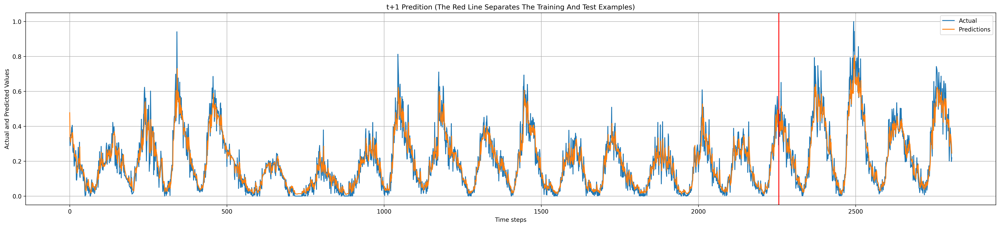

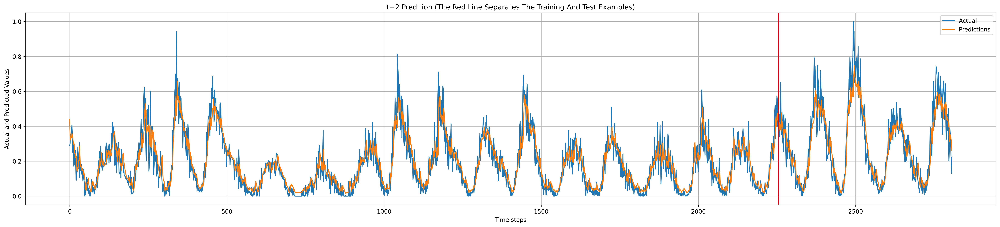

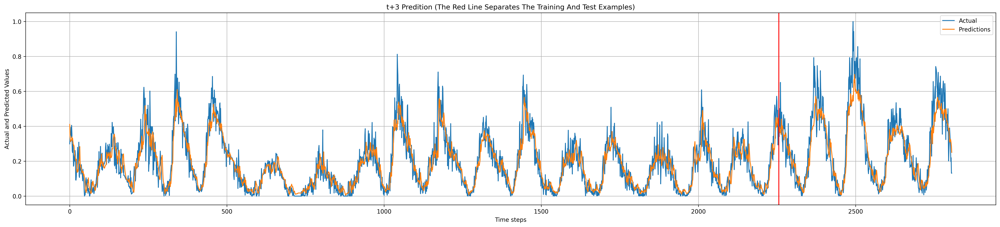

In [17]:
print ('***** LSTM MODEL *****')
train_predict = LSTM_model.predict(X)
test_predict = LSTM_model.predict(Xt)
df4 = RMSE(train_predict, test_predict)
plot_predict(train_predict, test_predict, y, yt)

In [18]:
# Plot the prediction error
def plot_result2(trainY, testY, train_predict, test_predict,i):
    actual = np.append(trainY, testY)
    predictions = np.append(train_predict, test_predict)
    rows = len(actual)
    plt.figure(figsize=(30, 6), dpi=300)
    plt.plot(range(rows), actual - predictions)
    plt.axvline(x=len(trainY), color='r')
    plt.xlabel('Time steps')
    plt.ylabel('Actual minus Predicted Values')
    plt.title('t+%d Predition Error (The Red Line Separates The Training And Test Examples)' % (i+1))
    plt.ylim(-0.5, +1.0) # Please, set the interval appropriately, considering all the graphs.
    plt.grid(True)

def plot_error_predict(train_predict, test_predict, y, yt):
    for i in range(horizon):
      if(horizon == 1):
        y1_pred = train_predict
        y1_pred_t = test_predict
        y1 = y
        y1_t = yt
      elif(horizon > 1):
        y1_pred = train_predict[:,i]
        y1_pred_t = test_predict[:,i]
        y1 = y[:,i]
        y1_t = yt[:,i]
      plot_result2(y1, y1_t, y1_pred, y1_pred_t,i)

***** RNN MODEL *****
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 954us/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


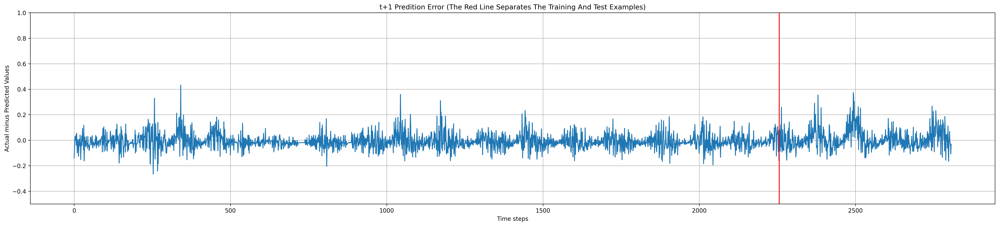

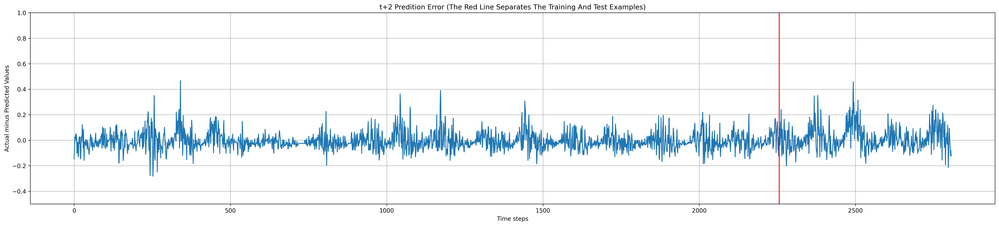

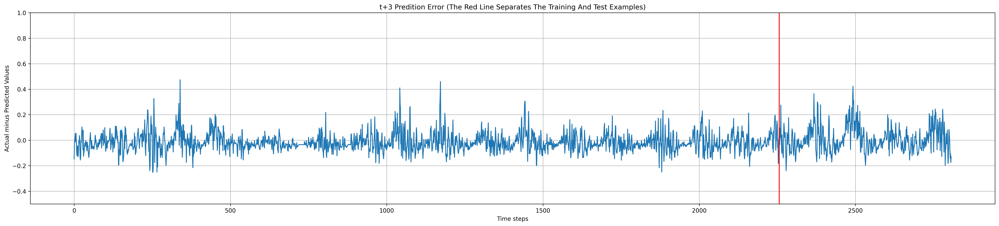

In [19]:
print ('***** RNN MODEL *****')
train_predict = RNN_model.predict(X)
test_predict = RNN_model.predict(Xt)
plot_error_predict(train_predict, test_predict, y, yt)


***** LINEAR MODEL *****


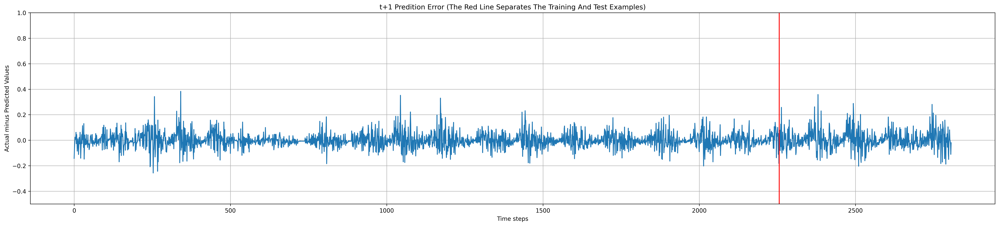

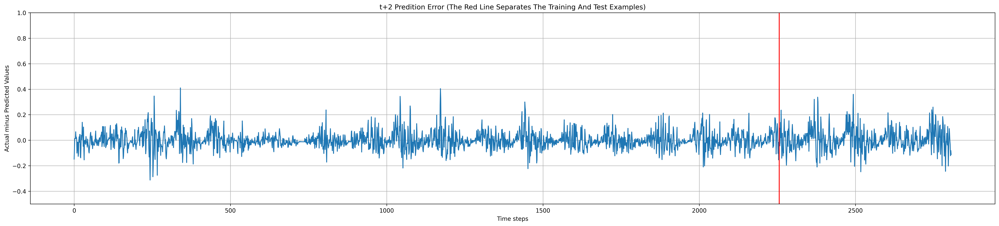

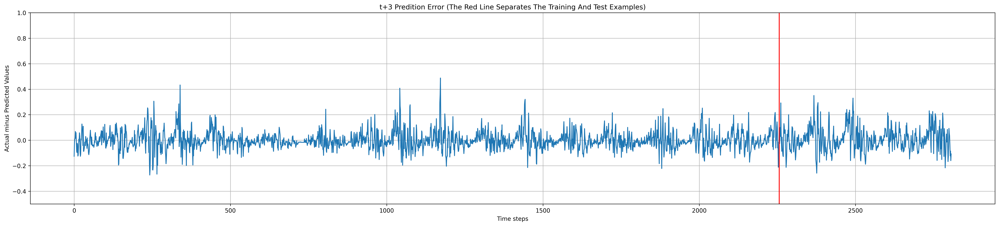

In [20]:
print ('***** LINEAR MODEL *****')
train_predict = linear_model.predict(X)
test_predict = linear_model.predict(Xt)
plot_error_predict(train_predict, test_predict, y, yt)

***** MLP MODEL *****
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 629us/step


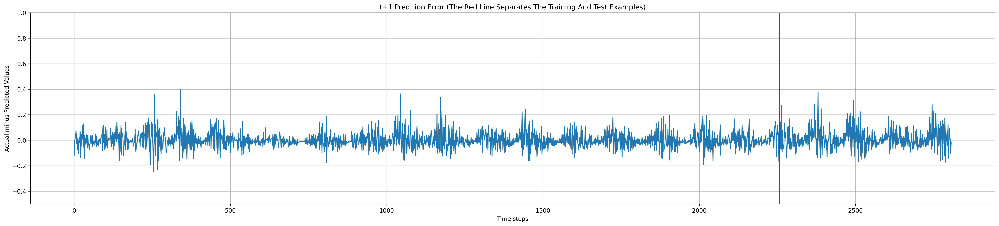

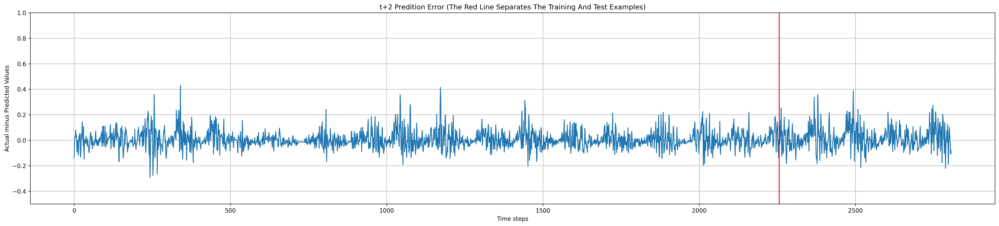

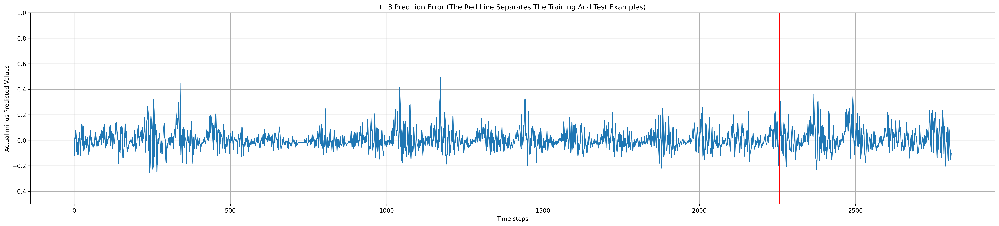

In [21]:
print ('***** MLP MODEL *****')
train_predict = MLP_model.predict(X)
test_predict = MLP_model.predict(Xt)
plot_error_predict(train_predict, test_predict, y, yt)

***** LSTM MODEL *****
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


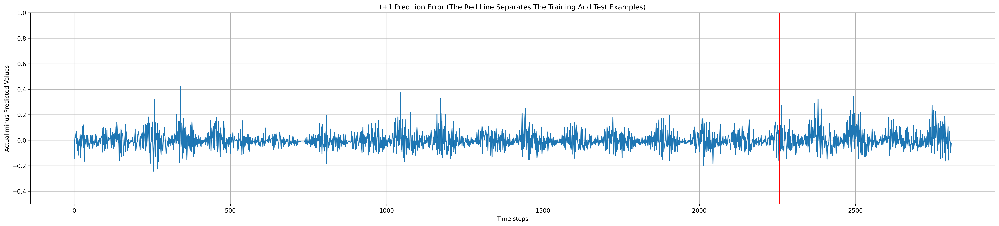

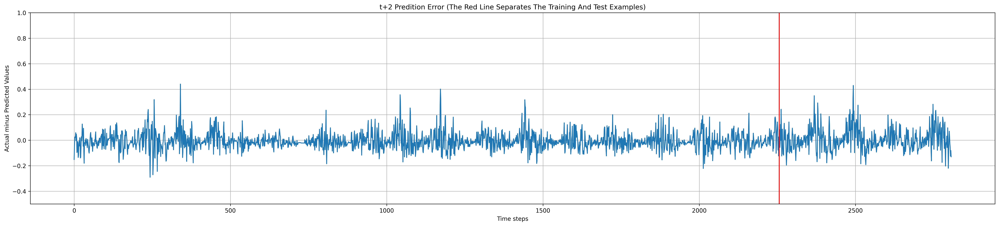

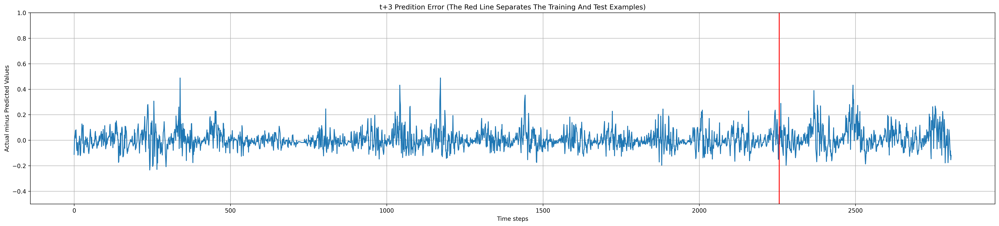

In [22]:
print ('***** LSTM MODEL *****')
train_predict = LSTM_model.predict(X)
test_predict = LSTM_model.predict(Xt)
plot_error_predict(train_predict, test_predict, y, yt)

## **Exhibit a dataframe with the final results for each predictor**

In [23]:
DF_results = pd.concat([df1, df2, df3, df4], axis=1, keys=['RNN', 'LINEAR', 'MLP', 'LSTM'])
DF_results.index = ['t+1', 't+2', 't+3']
DF_results

RNN              LINEAR                 MLP                LSTM  \
        train      test     train      test     train      test     train   
t+1  0.059655  0.082038  0.058257  0.073480  0.058587  0.075277  0.057911   
t+2  0.067555  0.095912  0.066630  0.087041  0.067011  0.089222  0.065874   
t+3  0.073386  0.099572  0.071136  0.093434  0.071283  0.094819  0.069701   

               
         test  
t+1  0.075362  
t+2  0.088552  
t+3  0.097077

<font color="green">
Atividade (a) <br>
Explique o papel dos parâmetros de projeto [time_steps] e [horizon].
</font>

Resposta:<br><br>

**time_steps**<br>
Determina o número de passos temporais anteriores utilizados como entrada para o modelo. Esse parâmetro representa a janela de observação que será usada para aprender padrões históricos.<br>
<br>
**horizon**<br>
Determina o número de passos futuros que o modelo deve prever. Esse parâmetro define o alcance da previsão, ou seja, se será de curto, médio ou longo prazo.

<font color="green">
Atividade (b) <br>
Qual a diferença no uso do parâmetro [time_steps] no caso dos preditores não-recorrentes e no caso do bloco LSTM?
</font>

Resposta:<br><br>
No caso dos modelos não-recorrentes, os dados referentes à janela de tempo time_steps são convertidos em um vetor de dados que será processado de forma única. Ademais, esses modelos não possuem memória interna, não registram estados internos que capturem relações temporais sequenciais. <br>
Já no caso do bloco LSTM, os dados da janela de tempo são processados sequencialmente e o modelo captura dependências temporais sequenciais em função da memória. 

<font color="green">
Atividade (c) <br>
Qual modelo de predição levou a um melhor desempenho junto aos dados de teste em cada caso?
</font>

Resposta:<br><br>

Para *monthly_sunspot* o modelo linear supera todos os outros. Possivelmente, uma justificativa é o fato de qeu temos dados "comportados" e sem intempéries como no caso de *unemployment_rate*. Para esse dataset, a Rede Neural Recorrente tem o melhor desempenho entre os modelos.
